In [4]:
from __future__ import division, print_function
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.examples.tutorials.mnist import input_data

In [8]:
# MNIST data
mnist=input_data.read_data_sets('../data/MNIST_data/',one_hot=True)

Extracting ../data/MNIST_data/train-images-idx3-ubyte.gz
Extracting ../data/MNIST_data/train-labels-idx1-ubyte.gz
Extracting ../data/MNIST_data/t10k-images-idx3-ubyte.gz
Extracting ../data/MNIST_data/t10k-labels-idx1-ubyte.gz


Total Training Images in Dataset = (55000, 784)
-------------------------------------------------
x_train Examples Loaded = (55000, 784)
y_train Examples Loaded = (55000, 10)

[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]


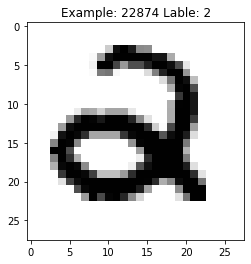

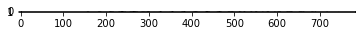

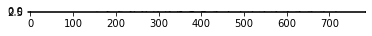

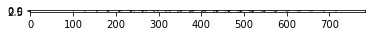

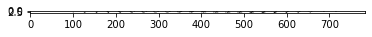

...

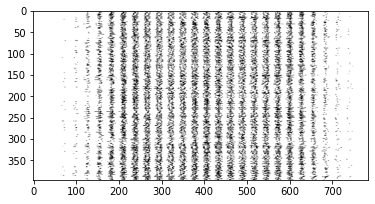

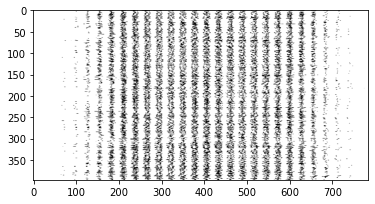

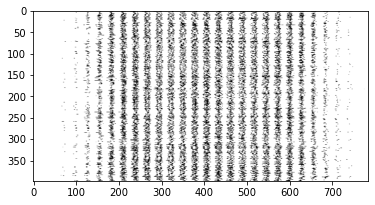

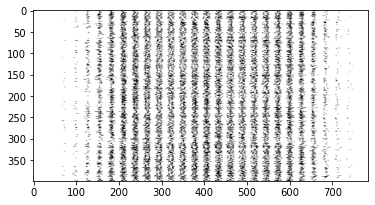

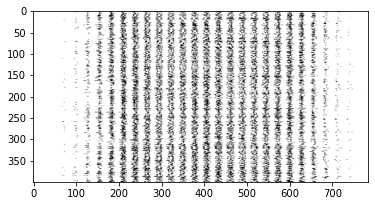

In [13]:
# observe data
def train_size(num):
    print('Total Training Images in Dataset = ' + str(mnist.train.images.shape))
    print('-------------------------------------------------')
    x_train=mnist.train.images[:num,:]
    print('x_train Examples Loaded = ' + str(x_train.shape))
    y_train=mnist.train.labels[:num,:]
    print('y_train Examples Loaded = ' + str(y_train.shape))
    print('')
    return x_train, y_train

def test_size(num):
    print('Total Test Images in Dataset = ' + str(mnist.test.images.shape))
    print('-------------------------------------------------')
    x_test=mnist.test.images[:num,:]
    print('x_test Examples Loaded = ' + str(x_test.shape))
    y_test=mnist.test.labels[:num,:]
    print('y_test Examples Loaded = ' + str(y_test.shape))
    print('')
    return x_test, y_test

def display_digit(num):
    print(y_train[num])
    label=y_train[num].argmax(axis=0)
    image=x_train[num].reshape([28,28])
    plt.title('Example: %d Lable: %d' %(num, label))
    plt.imshow(image,cmap=plt.get_cmap('gray_r'))
    plt.show()
    
def display_mult_flat(start,stop):
    images=x_train[start].reshape([1,784])
    for i in range(start+1,stop):
        images=np.concatenate((images, x_train[i].reshape([1,784])))
        plt.imshow(images,cmap=plt.get_cmap('gray_r'))
        plt.show()
        
        
x_train,y_train=train_size(55000)
display_digit(np.random.randint(0,x_train.shape[0]))
display_mult_flat(0,400)

In [14]:
# hyperparameters
learning_rate=0.001
training_iters=500
batch_size=128
display_step=10
# network parameters
n_input=784
n_classes=10
dropout=0.85

In [24]:
# define weights and biases
weights={
    # 5x5 conv, 1 channel, 32 filters
    'wc1':tf.Variable(tf.random_normal([5,5,1,32])),
    # 5x5 conv, 32 channel, 64 fiters
    'wc2':tf.Variable(tf.random_normal([5,5,32,64])),
    
    #fully-connected, 7*7*64 input, 1024 output
    'wd1':tf.Variable(tf.random_normal([7*7*64,1024])),
    # 1024 input, 10 output
    'out':tf.Variable(tf.random_normal([1024,n_classes]))
}

biases={
    'bc1':tf.Variable(tf.random_normal([32])),
    'bc2':tf.Variable(tf.random_normal([64])),
    'bd1':tf.Variable(tf.random_normal([1024])),
    'out':tf.Variable(tf.random_normal([n_classes]))
}

In [28]:
# create model
x=tf.placeholder(tf.float32,shape=[None, n_input],name='X')
y=tf.placeholder(tf.float32,shape=[None, n_classes],name='Y')
keep_prob=tf.placeholder(tf.float32)

# define conv2d
def conv2d(x,W,b,strides=1):
    x=tf.nn.conv2d(x,filter=W, strides=[1,strides,strides,1],padding='SAME')
    x=tf.nn.bias_add(x,b)
    return tf.nn.relu(x)

# define pooling
def maxpool2d(x,k=2):
    return tf.nn.max_pool(x,ksize=[1,k,k,1],strides=[1,k,k,1],padding='SAME')

# define conv-net(两个卷积层，一个全链接层，一个dropout层)
def conv_net(x, weights, biases,dropout):
    x=tf.reshape(x, shape=[-1,28,28,1])
    #first conv-layer
    conv1=conv2d(x,weights['wc1'],biases['bc1'])
    #max pooling
    conv1=maxpool2d(conv1,k=2)
    #second conv-layer
    conv2=conv2d(conv1,weights['wc2'],biases['bc2'])
    #max-pooling
    conv2=maxpool2d(conv2,k=2)
    
    # reshape
    fc1=tf.reshape(conv2,[-1,weights['wd1'].get_shape().as_list()[0]])
    # fully-connected-layer
    fc1=tf.add(tf.matmul(fc1, weights['wd1']), biases['bd1'])
    fc1=tf.nn.relu(fc1)
    #dropout
    fc1=tf.nn.dropout(fc1,keep_prob=dropout)
    
    out=tf.add(tf.matmul(fc1,weights['out']), biases['out'])
    return out


pred=conv_net(x,weights,biases,keep_prob)
cost=tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits_v2(logits=pred,labels=y))
optimizer=tf.train.AdamOptimizer(learning_rate=learning_rate).minimize(cost)
correct_pred=tf.equal(tf.argmax(pred,axis=1),tf.argmax(y,1))
accuracy=tf.reduce_mean(tf.cast(correct_pred,tf.float32))
init=tf.global_variables_initializer()

In [ ]:
train_loss=[]
train_acc=[]
test_acc=[]
with tf.Session() as sess:
    sess.run(init)
    step=1
    while step<=training_iters:
        batch_x,batch_y=mnist.train.next_batch(batch_size)
        sess.run(optimizer,feed_dict={x:batch_x,y:batch_y,keep_prob:dropout})
        if step%display_step==0:
            loss_train,acc_train=sess.run([cost, accuracy],
                                          feed_dict={x:batch_x,y:batch_y,keep_prob:1.0})
            print("Iter "+str(step)+",Minibatch Loss= "+"{:.2f}".format(loss_train)+
                  ",Training Accuracy= "+"{:.2f}".format(acc_train))
            
            acc_test=sess.run(accuracy,feed_dict={x:mnist.test.images,y:mnist.test.labels,
                                                 keep_prob:1.0})
            print("Testing Accuracy:"+"{:.2f}".format(acc_test))
            
            train_loss.append(loss_train)
            train_acc.append(acc_train)
            test_acc.append(acc_testc)
        step+=1

Iter 10,Minibatch Loss= 23539.15Training Accuracy= 0.24


In [ ]:
eval_indices=range(0,training_iters,display_step)
# loss over time
plt.plot(eval_indices, train_loss,'k-')
plt.title("Softmax Loss per iteration")
plt.xlabel("Iteration")
plt.ylabel("Softmax Loss")
plt.show()
# train and test accuracy
plt.plot(eval_indices,train_acc,'k-',label="Train Set Accuracy")
plt.plot(eval_indices,test_acc,'r--',label="Test Set Accuracy")
plt.title("Train and Test Accuracy")
plt.xlabel("Iteration")
plt.ylabel("Accuracy")
plt.legend(loc='lower right')
plt.show()
